In [1]:
using CSV, DataFrames, Plots, Dates, DataFramesMeta, Statistics, LaTeXStrings, GLM, StatsModels, Plots.PlotMeasures, StatsPlots, CategoricalArrays, MultivariateStats, LsqFit

In [2]:
include("SegmentFourier.jl")

AverageSlumpSeries (generic function with 1 method)

<h3>Fourier Section<h3>

In [3]:
folder = "C:\\Users\\cmeri\\OneDrive - Dartmouth College\\Research\\Remote_Sensing\\Segmentation\\Sentinel\\Data\\Compiled_s002"
Paths = ImagePaths(folder)
color_plot, color_img = TrueColor(Paths[1])
preview(color_img)

Dict{String, Any} with 4 entries:
  "gui"         => Dict{String, Any}("window"=>GtkWindowLeaf(Ptr{GObject} @0x00…
  "roi"         => Dict{String, Any}("redraw"=>ObserverFunction[ObserverFunctio…
  "annotations" => Observable(Dict{UInt64, Any}())
  "clim"        => Observable(CLim{RGB{Float64}}(RGB{Float64}(0.0,0.0,0.0), RGB…

Mask Centroid: (50.43773119605425, 46.75955610357583)


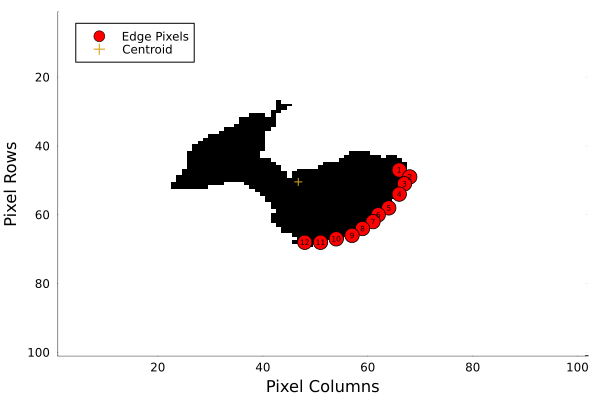

(Any[(66, 47), (68, 49), (67, 51), (66, 54), (64, 58), (62, 60), (61, 62), (59, 64), (57, 66), (54, 67), (51, 68), (48, 68)], Plot{Plots.GRBackend() n=3})

In [4]:
SelectedPoints, Edgeplot = Preprocess(Paths, 25, (50,50), (5,5), 0:8:100, Display=true)

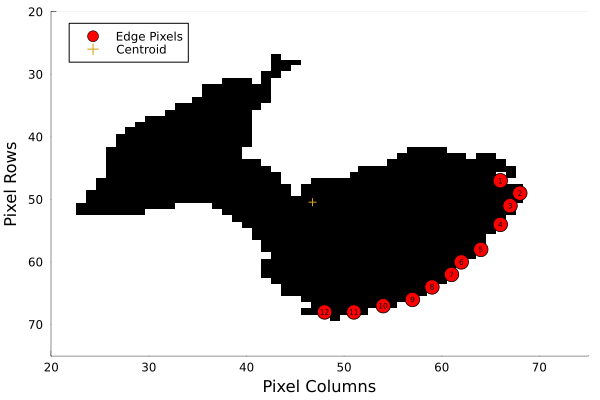

In [5]:
Edgeplot = plot(Edgeplot, xlims=(20,75), ylims=(20,75))

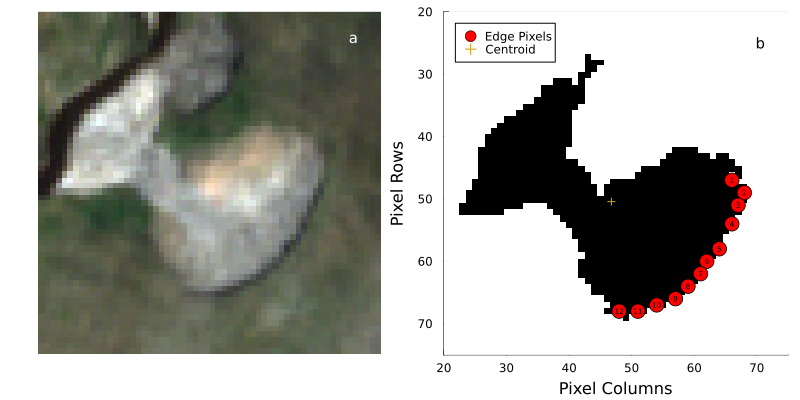

In [6]:
A = TrueColor(Paths[25], crop_size=(60,60))[1]
Plots.annotate!(55, 5, text("a", :left, 10, "white"))
Plots.annotate!(Edgeplot, 70, 25, text("b", :left, 10, "black"))
SegementationExample = plot(A, Edgeplot, size=(800,400), bottom_margin=10px)

In [7]:
results = AnalyzeSlump(Paths, SelectedPoints);

In [8]:
processed_s002 = DataFrame()

table = AverageSlumpSeries(results, "", dataframe=true)[2]
table.SlumpID .= "s002"
processed_list = vcat(processed_s002, table);

<h4>Visualization<h4>

In [9]:
Fourier = CSV.read("C:/Users/cmeri/OneDrive - Dartmouth College/Research/Remote_Sensing/Segmentation/Fourier/s002_Fourier_Special.csv",DataFrame)
QGIS = CSV.read(raw"C:\Users\cmeri\OneDrive - Dartmouth College\Research\Remote_Sensing\Segmentation\QGIS\s002\TransectDistances.csv", DataFrame)
Sentinel = CSV.read(raw"C:\Users\cmeri\OneDrive - Dartmouth College\Research\Remote_Sensing\Segmentation\QGIS\s002\SentinelDistances.csv", DataFrame);

In [10]:
function Extrema(Data, indicies)
    displacements = DataFrame()
    for index in 1:indicies
        df = Data[Data.SlumpID .== "s002", :]
        df = df[df.ID .== index, :]
        sort!(df, :Date)
        minimum_value = abs(minimum(df[:,"Value"]))
        df.Distance .= fill(NaN, nrow(df))
        df[1,"Distance"] = 0
        for i in 2:size(df)[1]
            df[i,"Distance"] = df[i, "Value"] + minimum_value
        end
        row = DataFrame(Index=index, Displacement=maximum(df.Distance))
        append!(displacements,row)
    end
    Mean = Statistics.mean(displacements.Displacement)
    SD = Statistics.std(displacements.Displacement)
    println("The mean retreat is $(Mean) pixels")
    println("The standard deviation of retreat is $(SD) pixels")
    return displacements
end

Extrema (generic function with 1 method)

In [11]:
Extrema(Fourier, 12)

The mean retreat is 10.33662420858301 pixels
The standard deviation of retreat is 3.09081452691101 pixels


Row,Index,Displacement
,Int64,Float64
1,1,4.0834
2,2,4.95073
3,3,7.59134
4,4,9.84419
5,5,11.4514
6,6,12.0335
7,7,12.0954
8,8,12.0843
9,9,12.6554


In [12]:
function FourierPlot(Data)
    df = Data[Data.SlumpID .== "s002", :]
    df = df[df.ID .== 6, :]
    sort!(df, :Date)
    minimum_value = abs(minimum(df[:,"Value"]))
    df.Distance .= fill(NaN, nrow(df))
    df[1,"Distance"] = 0
    for i in 2:size(df)[1]
        df[i,"Distance"] = (df[i, "Value"] + minimum_value) - (df[i-1, "Value"] + minimum_value)
    end
    print(df)
    p = scatter(df.Date, df.Value .+ minimum_value, xlabel="Date", ylabel="Cumulative Distance", label="Fourier")
    return p, df
end

FourierPlot (generic function with 1 method)

29×6 DataFrame
 Row │ Value       Date        ID     DayOfYear  SlumpID  Distance    
     │ Float64     Date        Int64  Float64    String7  Float64     
─────┼────────────────────────────────────────────────────────────────
   1 │ -6.2034     2016-06-07      6      160.0  s002     0.0
   2 │ -5.23949    2016-08-06      6      220.0  s002     0.963918
   3 │ -4.88246    2017-06-09      6      160.0  s002     0.35703
   4 │ -4.77383    2017-07-12      6      190.0  s002     0.10863
   5 │ -4.60579    2017-07-20      6      200.0  s002     0.168034
   6 │ -3.86125    2017-08-21      6      230.0  s002     0.744545
   7 │ -3.32674    2018-06-04      6      160.0  s002     0.534504
   8 │ -3.04351    2018-07-14      6      200.0  s002     0.283232
   9 │ -2.69156    2018-07-30      6      210.0  s002     0.351955
  10 │ -2.41819    2019-06-07      6      160.0  s002     0.273364
  11 │ -1.96798    2019-07-27      6      210.0  s002     0.450217
  12 │ -1.37352    2019-09-07      6      

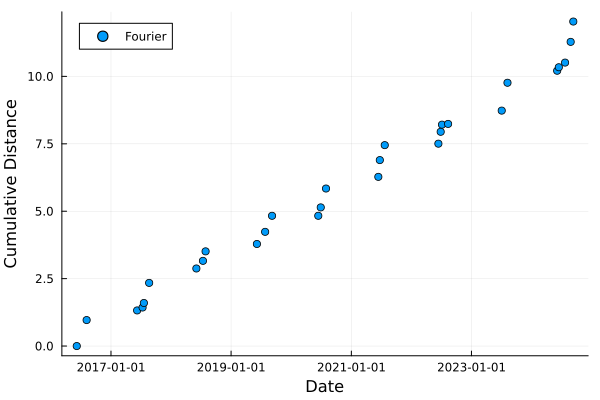

In [13]:
p, t = FourierPlot(Fourier)
p

In [14]:
sort!(Sentinel, :Date);

In [15]:
Sentinel.Distance .= fill(NaN, nrow(Sentinel))
Sentinel[1,"Distance"] = 0
for i in 2:size(Sentinel)[1]
    Sentinel[i,"Distance"] = (Sentinel[i, "Line"]) - (Sentinel[i-1, "Line"])
end

In [16]:
Sentinel.CumulativeDistance = cumsum(Sentinel.Distance);

original_format = "yyyy/mm/dd HH:MM:SS"
Sentinel.Date = DateTime.(Sentinel.Date, original_format)
Sentinel.Date = Date.(Sentinel.Date);
major_ticks = Date(2017,1,1):Year(1):Date(2024,1,1)
major_labels = Dates.format.(major_ticks, "yyyy")


minor_ticks = Date(2018,7,1):Year(1):Date(2024,7,1);

In [17]:
t.Value = (t.Value .+ abs.(minimum(t.Value))) .* 10;

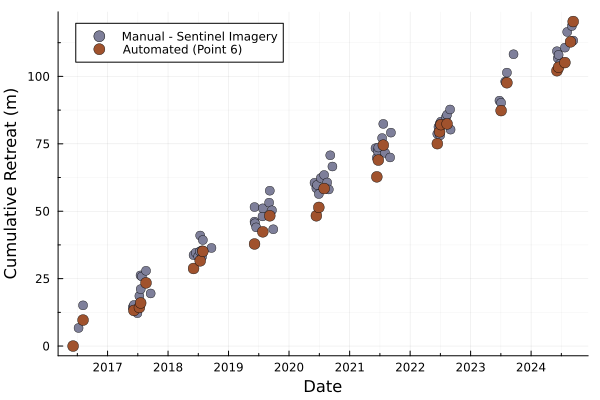

In [18]:
scatter(Sentinel.Date, Sentinel.CumulativeDistance, label="Manual - Sentinel Imagery", color=colorant"#7E7F9A", markerstrokewidth=0.5, markersize=5)
comp = scatter!(t.Date, t.Value, xlabel="Date", ylabel="Cumulative Retreat (m)", label="Automated (Point 6)", color=:sienna, markersize=6, minorgrid=true, minorticks = 2, xticks = (major_ticks, major_labels), markerstrokewidth=0.5)

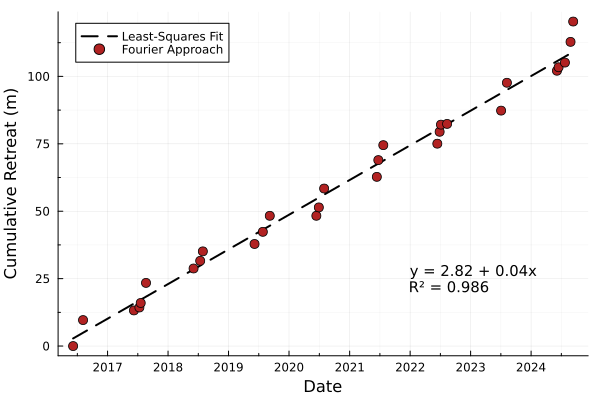

In [19]:
DataFrames.transform!(t, :Date => (d -> Dates.value.(d .- minimum(t.Date))) => :Days)
model = lm(@formula(Value ~ Days), t)
y_fit = predict(model)

coefs = coef(model)
b0 = coefs[1]        # Intercept
b1 = coefs[2]        # Slope
r2_val = r2(model)

equation_str = "y = $(round(b0, digits=2)) + $(round(b1, digits=2))x"
r2_str = "R² = $(round(r2_val, digits=3))"
annot_str = equation_str * "\n" * r2_str

plot(t.Date, y_fit, label="Least-Squares Fit", linewidth=2, color=:black, linestyle=:dash)
scatter!(t.Date, t.Value, xlabel="Date", ylabel="Cumulative Retreat (m)", label="Fourier Approach", color=:firebrick, markersize=5, minorgrid=true, minorticks = 2, xticks = (major_ticks, major_labels))
Sample = Plots.annotate!(Date("2022-01-01"), 25, text(annot_str, :left, 10, "black"))

<h5>Slump Average Retreat<h5>

In [20]:
function SlumpAverage(Data, indicies)
    data = DataFrame()
    for index in 1:indicies
        df = Data[Data.SlumpID .== "s002", :]
        df = df[df.ID .== index, :]
        sort!(df, :Date)
        minimum_value = abs(minimum(df[:,"Value"]))
        df.Distance .= fill(NaN, nrow(df))
        df.Retreat .= fill(NaN, nrow(df))
        df[1,"Distance"] = 0
        df[1,"Retreat"] = 0
        for i in 2:size(df)[1]
            df[i,"Distance"] = (df[i, "Value"] + minimum_value) .* 10
            df[i, "Retreat"] = df[i,"Distance"] - df[i-1,"Distance"]
        end
        data = vcat(data,df)
    end
    grouped = groupby(data, :Date)
    
    complete = filter(g -> nrow(g) == indicies, grouped)
    Average = combine(complete, :Distance => mean => :MeanDistance, :Retreat  => mean => :MeanRetreat)
    sort!(Average, :Date)
    return Average
end

SlumpAverage (generic function with 1 method)

In [21]:
AverageData = SlumpAverage(Fourier, 12)

Row,Date,MeanDistance,MeanRetreat
,Date,Float64,Float64
1,2016-06-07,0.0,0.0
2,2016-08-06,9.57167,9.57167
3,2017-07-12,13.1065,1.85946
4,2017-07-20,14.8136,1.70711
5,2018-07-14,27.1309,2.99895
6,2018-07-30,29.571,2.44011
7,2019-07-27,36.2685,4.47196
8,2019-09-07,41.1915,4.92302
9,2020-06-29,43.3785,1.98192


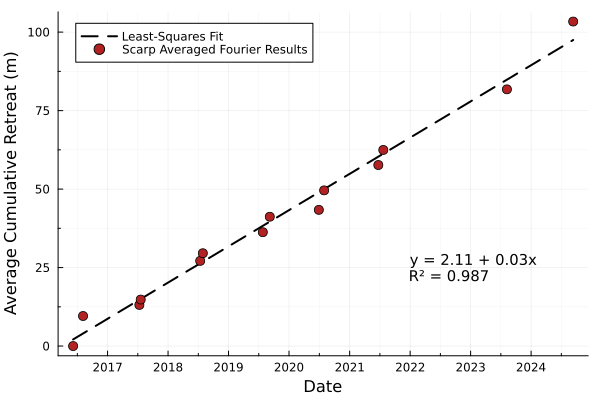

In [22]:
DataFrames.transform!(AverageData, :Date => (d -> Dates.value.(d .- minimum(AverageData.Date))) => :Days)
model = lm(@formula(MeanDistance ~ Days), AverageData)
y_fit = predict(model)

coefs = coef(model)
b0 = coefs[1]        # Intercept
b1 = coefs[2]        # Slope
r2_val = r2(model)

equation_str = "y = $(round(b0, digits=2)) + $(round(b1, digits=2))x"
r2_str = "R² = $(round(r2_val, digits=3))"
annot_str = equation_str * "\n" * r2_str

plot(AverageData.Date, y_fit, label="Least-Squares Fit", linewidth=2, color=:black, linestyle=:dash)
scatter!(AverageData.Date, AverageData.MeanDistance, xlabel="Date", ylabel="Average Cumulative Retreat (m)", label="Scarp Averaged Fourier Results", color=:firebrick, markersize=5, minorgrid=true, minorticks = 2, xticks = (major_ticks, major_labels))
AvPlot = Plots.annotate!(Date("2022-01-01"), 25, text(annot_str, :left, 10, "black"))

In [23]:
print(coeftable(model))

─────────────────────────────────────────────────────────────────────────
                 Coef.  Std. Error      t  Pr(>|t|)  Lower 95%  Upper 95%
─────────────────────────────────────────────────────────────────────────
(Intercept)  2.11147    1.54859      1.36    0.1978  -1.26262   5.48556
Days         0.0316026  0.00103067  30.66    <1e-12   0.029357  0.0338483
─────────────────────────────────────────────────────────────────────────

In [24]:
joined = innerjoin(Sentinel, t, on=:Date, makeunique=true)
println("Correlation Coefficeint: $(Statistics.cor(joined.CumulativeDistance, joined.Value))")

Correlation Coefficeint: 0.9937365257968637


<h3>Area Section<h3>

In [25]:
include("C:\\Users\\cmeri\\OneDrive - Dartmouth College\\Research\\Remote_Sensing\\Segmentation\\Sentinel\\Segmentation.jl")

segment_folder (generic function with 1 method)

In [26]:
data_path =  "C:\\Users\\cmeri\\OneDrive - Dartmouth College\\Research\\Remote_Sensing\\Segmentation\\Sentinel\\Data\\Compiled_s002"
files = ImagePaths(data_path)
TrueColor(files[1])[1];

Defaulting to no water mask.

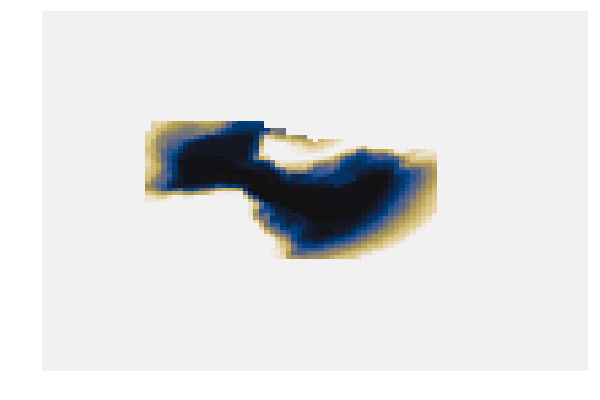

In [27]:
result = segment_folder(data_path,(58,51),(90,90),Seed3=(5,5), refine=true, dilation=10, Display=true)
result.ID .= "s002";

In [28]:
Area = result
s002Area = @rsubset Area :ID == "s002";

In [29]:
s002Area.Month = month.(s002Area.Date)
s002Area.Year = year.(s002Area.Date);

In [30]:
#Monotonic Enforcement
s002_monotonic = DataFrame(DataFrame(s002Area[1, [:Date, :Pixels]]))

for i in 2:(size(s002Area)[1])
    if s002Area[i, "Pixels"] >= s002_monotonic[end, "Pixels"]
        append!(s002_monotonic, DataFrame(Pixels=s002Area[i, "Pixels"], Date=s002Area[i, "Date"]))
    end
end
s002_monotonic.Area = s002_monotonic.Pixels .* 100;

In [31]:
Areaplot = scatter(s002_monotonic.Date, (s002_monotonic.Pixels .* 100)/(1e6), xlabel="Date", ylabel=latexstring("Area (\$km^2\$)"), markersize = 5, label="", color=:firebrick,minorgrid=true, minorticks = 2, xticks = (major_ticks, major_labels));

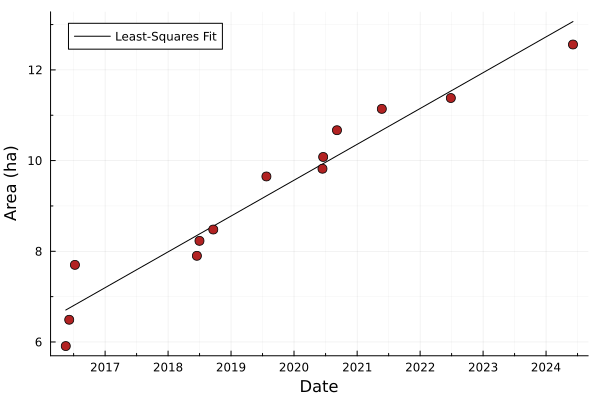

In [33]:
DataFrames.transform!(s002_monotonic, :Date => (d -> Dates.value.(d .- minimum(s002_monotonic.Date))) => :Days)

model = lm(@formula(Area ~ Days), s002_monotonic)
y_fit = predict(model)

coefs = coef(model)
b0 = coefs[1]        # Intercept
b1 = coefs[2]        # Slope
r2_val = r2(model)

equation_str = "y = $(round(b0, digits=2)) + $(round(b1, digits=2))x"
r2_str = "R² = $(round(r2_val, digits=3))"
annot_str = equation_str * "\n" * r2_str

plot(s002_monotonic.Date, y_fit / 1e4, label="Least-Squares Fit", linewidth=1, color=:black, linestyle=:solid, minorticks=2, minorgrid=true)
scatter!(s002_monotonic.Date, s002_monotonic.Area / (1e4), xlabel="Date", ylabel=("Area (ha)"), markersize = 5, label="", color=:firebrick,minorgrid=true, minorticks = 2, xticks = (major_ticks, major_labels))


In [34]:
println(r2_str)

R² = 0.942


In [35]:
(maximum(s002_monotonic.Area) - minimum(s002_monotonic.Area)) / (8)

8312.5

In [36]:
ManualArea = CSV.read(raw"C:/Users/cmeri/OneDrive - Dartmouth College/Research/Remote_Sensing/Segmentation/QGIS/s002/SentinelAreas.csv",DataFrame)
original_format = "yyyy/mm/dd"
ManualArea.Date = DateTime.(ManualArea.Date, original_format)
ManualArea.Date = Date.(ManualArea.Date);

In [37]:
LandsatArea = CSV.read(raw"C:/Users/cmeri/OneDrive - Dartmouth College/Research/Remote_Sensing/Segmentation/Landsat/LandsatArea.csv",DataFrame)
LandsatArea.Date = Dates.Date.(LandsatArea.Date, "yyyy/mm/dd")
sort!(LandsatArea, :Date);

In [38]:
scatter(LandsatArea.Date, LandsatArea.Area / 1e4, color=:tan, label="Manual - Landsat Imagery",markerstrokewidth=0.5,markersize=5)
scatter!(ManualArea.Date, (ManualArea.Area) / 1e4, label="Manual - Sentinel Imagery", color=colorant"#7E7F9A", minorgrid=true, yminorticks=1, xminorticks = 5, xticks = (Date(1995,1,1):Year(5):Date(2025,1,1), Dates.year.(Date(1995,1,1):Year(5):Date(2025,1,1))),markerstrokewidth=0.5,markersize=5)
TriplePlot = scatter!(s002_monotonic.Date, (s002_monotonic.Pixels .* 100)/(1e4), xlabel="Date", ylabel="Area (ha)", markersize = 5, color=:sienna, label="Seeded Segmentation",markerstrokewidth=0.5);

In [39]:
YearlySSC = CSV.read(raw"C:\Users\cmeri\OneDrive - Dartmouth College\Research\Remote_Sensing\Segmentation\SSC\s002_ssc_by_yday_pre_post.csv",DataFrame)
sort!(YearlySSC, :fractional_day)
AveragedSSC = combine(groupby(YearlySSC, :fractional_2month), :SSC_mgL => mean => :MonthSSC, :SSC_mgL => sem => :StErSSC, :reference => :reference);

In [40]:
scatter(YearlySSC.fractional_day,YearlySSC.SSC_mgL, color=:goldenrod, alpha=0.2,markershape=:diamond, xlims=(1994.5,2025.5), label="Affected Reach, Individual Dates")
plot!(AveragedSSC.fractional_2month,AveragedSSC.MonthSSC, color=:goldenrod, label="")
SSCyear = scatter!(AveragedSSC.fractional_2month,AveragedSSC.MonthSSC, yerror=AveragedSSC.StErSSC, color=:goldenrod, xlabel="Date", ylabel="SSC (mg/L)", legend=:topleft, markerstrokewidth=0.5, markersize=5, size=(600,300), label="Affected Reach, 2-Month Average");

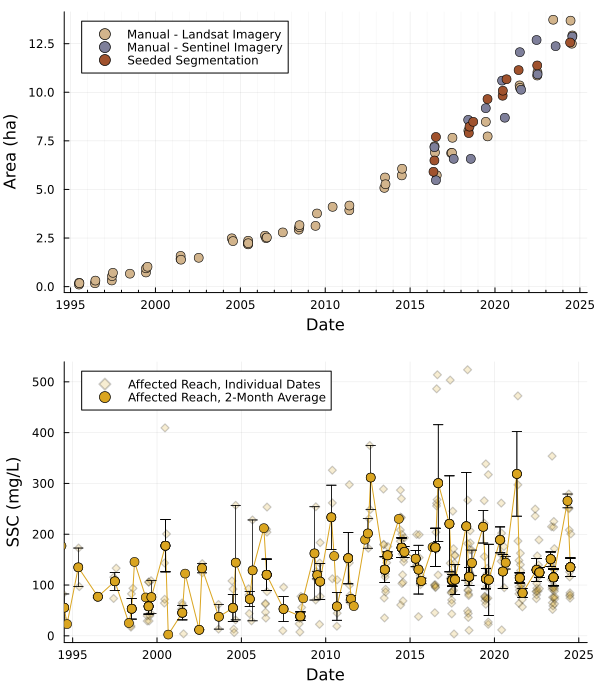

In [41]:
AreaSSC = plot(TriplePlot, SSCyear, layout=grid(2, 1, heights = [0.5, 0.5]), size=(600,700))

In [42]:
ReachComp = CSV.read(raw"C:\Users\cmeri\OneDrive - Dartmouth College\Research\Remote_Sensing\Segmentation\Fourier\landsat_ssc_slump_s002.csv",DataFrame)
ReachComp.reference[ReachComp.reference .!= "Reference"] .= "Affected";
ReachComp.Year = year.(ReachComp.sample_dt)
ReachComp.Month = month.(ReachComp.sample_dt)

ReachComp = filter(x ->  5 < x.Month < 10, ReachComp)

ReachComp = combine(groupby(ReachComp, [:Year, :reference]), :SSC_mgL => mean => :SeasonMeanSSC, :Year => :Year);

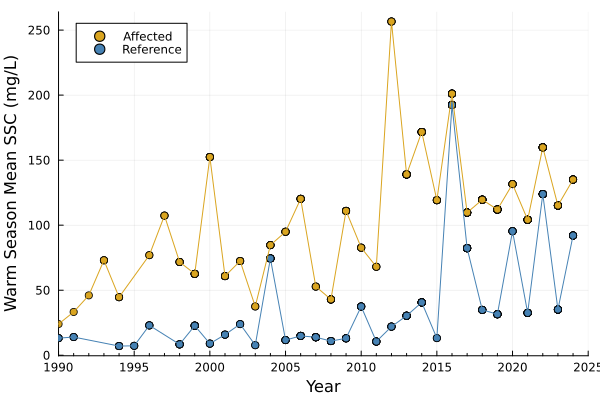

In [43]:
scatter(ReachComp.Year,ReachComp.SeasonMeanSSC, group=ReachComp.reference, color=[:goldenrod :steelblue], xlims=(1990,2025), xlabel= "Year", ylabel="Warm Season Mean SSC (mg/L)", legend=:topleft)
plot!(ReachComp.Year,ReachComp.SeasonMeanSSC, group=ReachComp.reference, color=[:goldenrod :steelblue], label="", xlims=(1990,2025), xminorticks=5)

Fitted parameters: [18272.93929907125, 0.000196649233016669, -15224.339092032626]


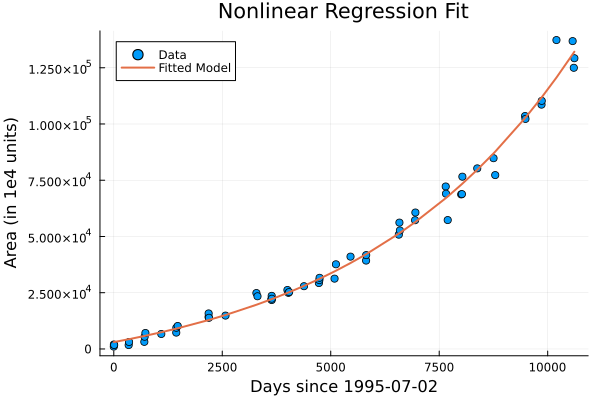

In [44]:
t0 = minimum(LandsatArea.Date)
xdata = Float64.([Dates.value(d - t0) for d in LandsatArea.Date])
ydata = LandsatArea.Area

# Define a nonlinear model. Example: an exponential model: y = a * exp(b*x) + c
Model(x, p) = p[1] .* exp.(p[2] .* x) .+ p[3]

# Provide an initial guess for the parameters [a, b, c]
p0 = [1.0, 0.001, 0.0]

# Perform the curve fit
Fit = curve_fit(Model, xdata, ydata, p0)
println("Fitted parameters: ", Fit.param)

# Plot the original data and the fitted curve for visualization
scatter(xdata, ydata, label="Data", xlabel="Days since $(t0)", ylabel="Area (in 1e4 units)", title="Nonlinear Regression Fit")
plot!(xdata, Model(xdata, Fit.param), label="Fitted Model", lw=2)

In [45]:
yfit = Model(xdata, Fit.param)

ss_res = sum((ydata .- yfit).^2)

# Calculate the total sum of squares
ss_tot = sum((ydata .- mean(ydata)).^2)

# Compute the R-squared value
r_squared = 1 - ss_res / ss_tot

println("R squared: ", r_squared)

R squared: 0.9896657847654319


In [46]:
DataFrames.transform!(s002_monotonic, :Date => (d -> Dates.value.(d .- minimum(AverageData.Date))) => :Days)
AreaModel = lm(@formula(Area ~ Days), s002_monotonic)
print(coeftable(AreaModel))

───────────────────────────────────────────────────────────────────────────
                  Coef.  Std. Error      t  Pr(>|t|)   Lower 95%  Upper 95%
───────────────────────────────────────────────────────────────────────────
(Intercept)  67478.1     2323.33     29.04    <1e-11  62364.5     72591.7
Days            21.6382     1.62555  13.31    <1e-07     18.0603     25.216
───────────────────────────────────────────────────────────────────────────

In [47]:
AreaEstimate = 20.3355 * (Dates.value(Date("2017-07-01") - minimum(AverageData.Date))) + 70389.5

78300.0095

In [48]:
Max = maximum(s002_monotonic.Pixels) .* 100 / (1e4)
Min = minimum(s002_monotonic.Pixels) .* 100 / (1e4)
println("Maximum of $(Max) sq. hm")
println("Minimum of $(Min) sq. hm")
println("Growth: $(Max - Min) sq. hm")


Maximum of 12.56 sq. hm
Minimum of 5.91 sq. hm
Growth: 6.65 sq. hm


<h3>Climate<h3>

In [49]:
Climate = CSV.read(raw"C:\Users\cmeri\OneDrive - Dartmouth College\Research\Remote_Sensing\Segmentation\Climate\ClimateData.csv",DataFrame)
Climate.precipitation .= 
if month.(Climate.time) ∈ [1,3,5,7,8,10,12] 
    Climate.precipitation .* 31
elseif month.(Climate.time) == 2 && year.(Climate.time) ∈ [1980,1984,1988,1992,1996,2000,2004,2008,2012,2016,2020,2024]
    Climate.precipitation .* 29
elseif month.(Climate.time) == 2 && year.(Climate.time) ∉ [1980,1984,1988,1992,1996,2000,2004,2008,2012,2016,2020,2024]
    Climate.precipitation .* 28
else
    Climate.precipitation .* 30
end;

In [50]:
Climate.year .= year.(Climate.time)
Climate.month .= month.(Climate.time);

In [51]:
p1 = plot(Climate.time, Climate.precipitation, color=:cornflowerblue, label="NARR Precipitation", xlabel="Date", ylabel=latexstring("Precipitation (\$kg/m^2\$)"),minorgrid=true, minorticks = 2, xticks = (major_ticks, major_labels), xlims=Dates.value.([Date("2016-01-01"), Date("2025-01-01")]));

In [52]:
p2 = plot(Climate.time, Climate.temperature .- 272.15, color=:firebrick, xlabel="Date", ylabel=latexstring("Temperature (\$\\degree C\$)"), label="NARR Temperature", minorgrid=true, minorticks = 2, xticks = (major_ticks, major_labels), xlims=Dates.value.([Date("2016-01-01"), Date("2025-01-01")]), legend=:bottomright);

In [53]:
WarmSeason = filter(row -> 6 <= row.month <= 9, Climate)
ColdSeason = filter(row -> (6 > row.month) || (row.month > 9), Climate);

In [54]:
WarmSeason.TempZScore .= zscore(WarmSeason.temperature)
WarmSeason.PrecipZScore .= zscore(WarmSeason.precipitation);

In [55]:
AverageData.month .= month.(AverageData.Date)
AverageData.year .= year.(AverageData.Date)

ClimatRetreat = innerjoin(AverageData, WarmSeason, on=[:year, :month]);

In [56]:
AveragedClimate = combine(groupby(WarmSeason, :year), :precipitation => mean => :MeanPrecip, :temperature => mean => :MeanTemp);

In [57]:
ColdSeason.ColdYear = ifelse.(ColdSeason.month .< 6, ColdSeason.year .- 1, ColdSeason.year)
ColdAverage = combine(groupby(ColdSeason, :ColdYear), :precipitation => mean => :MeanPrecip, :temperature => mean => :MeanTemp);

In [58]:
pmodel = lm(@formula(MeanPrecip ~ year), AveragedClimate)
tmodel = lm(@formula(MeanTemp ~ year), AveragedClimate)
print(coeftable(pmodel))
print(coeftable(tmodel))

───────────────────────────────────────────────────────────────────────────────
                   Coef.   Std. Error      t  Pr(>|t|)    Lower 95%   Upper 95%
───────────────────────────────────────────────────────────────────────────────
(Intercept)  -20.5317     135.625      -0.15    0.8804  -293.866     252.802
year           0.0237493    0.0677601   0.35    0.7276    -0.112812    0.160311
─────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
                   Coef.  Std. Error     t  Pr(>|t|)    Lower 95%    Upper 95%
──────────────────────────────────────────────────────────────────────────────
(Intercept)  251.624      31.4115     8.01    <1e-09  188.319      314.93
year           0.0156046   0.0156936  0.99    0.3255   -0.0160238    0.0472331
──────────────────────────────────────────────────────────────────────────────

In [59]:
println("Temperature Maximum: $(maximum(AveragedClimate.MeanTemp) - 273.15)")
println("Temperature Minimum: $(minimum(AveragedClimate.MeanTemp) - 273.15)")
println("Preciptation Maximum: $(maximum(AveragedClimate.MeanPrecip))")
println("Preciptation Minimum: $(minimum(AveragedClimate.MeanPrecip))")

Temperature Maximum: 13.742349243164256
Temperature Minimum: 7.231217956543048
Preciptation Maximum: 39.76165972066549
Preciptation Minimum: 14.145318372059158


In [60]:
AveragedClimate.zPrecip = zscore(AveragedClimate.MeanPrecip)
AveragedClimate.zTemp = zscore(AveragedClimate.MeanTemp);

In [61]:
AveragedClimate.alpha .= ifelse.((AveragedClimate.year .< 2016), 0.25, 1.0);
Mp = scatter(AveragedClimate.year, AveragedClimate.MeanPrecip, color=:cornflowerblue, markersize =7, alpha=AveragedClimate.alpha, label="", xlabel="Year", ylabel="Mean Precipitation (mm)", xlims=(1980,2024.5), xticks = (1980:10:2025))
plot!(AveragedClimate.year, AveragedClimate.MeanPrecip, linestyle=:dash, color=:cornflowerblue, label="", guidefontsize=18, tickfontsize=15);

In [62]:
Tp = scatter(AveragedClimate.year, AveragedClimate.MeanTemp .- 273.15, color=:firebrick, markersize=7, alpha=AveragedClimate.alpha, label="", xlabel="Year", ylabel=latexstring("Mean Temperature (\$\\degree C\$)"), xlims=(1980,2024.5), xticks = (1980:10:2025), yticks=(8:2:14))
plot!(AveragedClimate.year, AveragedClimate.MeanTemp .- 273.15, linestyle=:dash, color=:firebrick, label="", tickfontsize=15, guidefontsize=18);

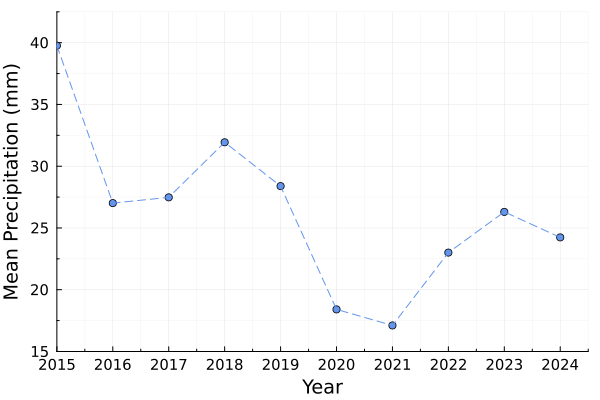

In [63]:
MainPrecip = scatter(AveragedClimate.year, AveragedClimate.MeanPrecip, color=:cornflowerblue, label="", xlabel="Year", ylabel="Mean Precipitation (mm)",
    minorgrid=true, xminorticks = 2, xlims=(2015,2024.5), xticks = (2015:1:2025), yminorticks=2,ylims=(15,42.5))
plot!(AveragedClimate.year, AveragedClimate.MeanPrecip, linestyle=:dash, color=:cornflowerblue, label="", guidefontsize=13, tickfontsize=10)

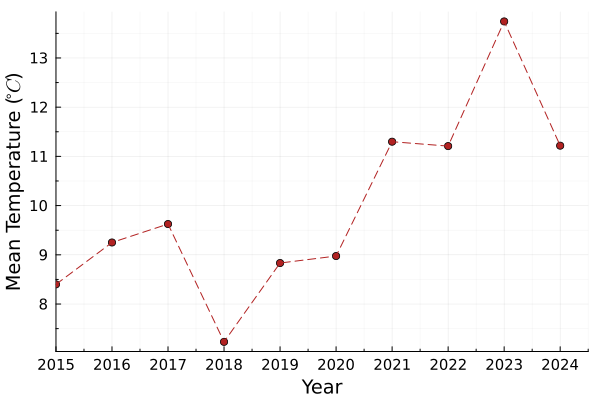

In [64]:
MainTemp = scatter(AveragedClimate.year, AveragedClimate.MeanTemp .- 273.15, color=:firebrick, label="", xlabel="Year", ylabel=latexstring("Mean Temperature (\$\\degree C\$)"),
    minorgrid=true, xminorticks = 2, xlims=(2015,2024.5), xticks = (2015:1:2025), yminorticks=2)
plot!(AveragedClimate.year, AveragedClimate.MeanTemp .- 273.15, linestyle=:dash, color=:firebrick, label="",guidefontsize=13, tickfontsize=10)

<h3>Seasonal Retreat<h3>

In [65]:
function SeasonalRetreat(Data, indicies)
    data = DataFrame()
    results = DataFrame()

    for index in 1:indicies
        df = Data[Data.SlumpID .== "s002", :]
        df = df[df.ID .== index, :]
        sort!(df, :Date)
        minimum_value = abs(minimum(df[:,"Value"]))
        df.Distance .= fill(NaN, nrow(df))
        df.Retreat .= fill(NaN, nrow(df))
        df[1,"Distance"] = 0
        df[1,"Retreat"] = 0
        for i in 2:size(df)[1]
            df[i,"Distance"] = (df[i, "Value"] + minimum_value) .* 10
            df[i, "Retreat"] = df[i,"Distance"] - df[i-1,"Distance"]
        end
        data = vcat(data,df)
    end

    data.year = year.(data.Date)
    years = unique(data.year)
    pop!(years)

    for index in 1:indicies
        df = data[data.SlumpID .== "s002", :]
        df = df[df.ID .== index, :]

        # Cold Season
        for j in years
            end_date = maximum(df[df.year .== j, "Date"])
            start_date = minimum(df[df.year .== (j+1), "Date"])
            Retreat = df[df.Date .== start_date, "Distance"] - df[df.Date .== end_date, "Distance"]
            Elapsed_time = Dates.value(start_date - end_date)
            Rate = Retreat / Elapsed_time
            row = DataFrame(Season="Cold", RetreatRate = Rate, year = j, Point=index)
            append!(results,row)
        end

        # Warm Season
        for j in years
            last_date = maximum(df[df.year .== j, "Date"])
            first_date = minimum(df[df.year .== j, "Date"])
            Retreat = df[df.Date .== last_date, "Distance"] - df[df.Date .== first_date, "Distance"]
            Elapsed_time = Dates.value(last_date - first_date)
            Rate = Retreat / Elapsed_time
            row = DataFrame(Season="Warm", RetreatRate = Rate, year = j, Point=index)
            append!(results,row)
        end
    end
   return results
end

SeasonalRetreat (generic function with 1 method)

In [66]:
Seasonal = SeasonalRetreat(Fourier, 12);

In [67]:
groupedSeason = groupby(filter(row -> !isnan(row.RetreatRate), Seasonal), [:Season, :year])
SeasonalResults = combine(groupedSeason, :RetreatRate => mean => :MeanRate, :RetreatRate => Statistics.std => :StDevRate, :RetreatRate => StatsBase.sem => :StErRate);

In [68]:
RecentClimate = filter(row -> row.year >= 2015, AveragedClimate)
ColdClimate = filter(row -> row.ColdYear >= 2015, ColdAverage)
ColdClimate.year = ColdClimate.ColdYear;

In [69]:
joinRetreat = innerjoin(SeasonalResults, RecentClimate, on=:year)
joinCold = innerjoin(SeasonalResults, ColdClimate, on=:year);

In [70]:
WarmJoin = filter(row -> row.Season == "Warm", joinRetreat)
println("Temperature Correlation Coefficeint: $(Statistics.cor(WarmJoin.MeanRate, WarmJoin.MeanTemp))")
println("Precipitaion Correlation Coefficeint: $(Statistics.cor(WarmJoin.MeanRate, WarmJoin.MeanPrecip))")

ColdJoin = filter(row -> row.Season == "Cold", joinCold)
println("Temperature Correlation Coefficeint: $(Statistics.cor(ColdJoin.MeanRate, ColdJoin.MeanTemp))")
println("Precipitaion Correlation Coefficeint: $(Statistics.cor(ColdJoin.MeanRate, ColdJoin.MeanPrecip))")

Temperature Correlation Coefficeint: 0.880625342002601
Precipitaion Correlation Coefficeint: -0.4441035406868936
Temperature Correlation Coefficeint: 0.48337881109716674
Precipitaion Correlation Coefficeint: 0.3108963126949774


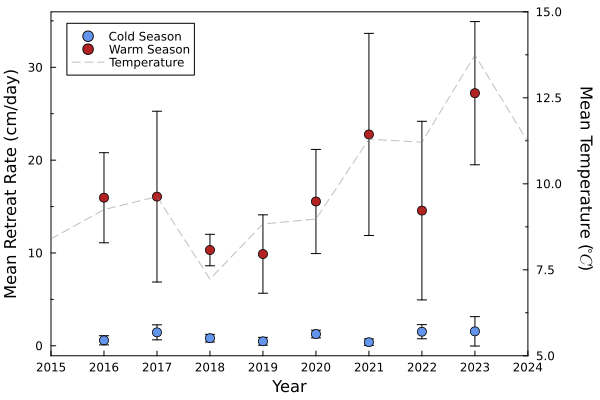

In [71]:
scatter(SeasonalResults.year, SeasonalResults.MeanRate .* 100, yerr=SeasonalResults.StDevRate.*100, group=SeasonalResults.Season, label=["Cold Season" "Warm Season" "Temperature"], legend=:topleft, ylabel="Mean Retreat Rate (cm/day)", xlabel="Year", color=[:cornflowerblue :firebrick], markersize=5, xlims=(2015,2024), yminorticks=2, xticks=(2015:1:2024))
plot!(SeasonalResults.year, SeasonalResults.MeanRate.*NaN, label="Temperature", color=:gray, linestyle=:dash, alpha=0.5)
plot!(twinx(), RecentClimate.year, RecentClimate.MeanTemp .- 273.15, xlims=(2015,2024), label="", color=:gray, ylims=(5,15), linestyle=:dash, alpha=0.5, yminorticks=2)
plot!(twiny(), xticks=false)
SeasonalRetreatPlot = Plots.annotate!(2025.1,18,Plots.text(latexstring("Mean Temperature (\$\\degree C\$)"),11, rotation=-90), right_margin=30px)
#Plots.annotate!(2018, 15, "Pearson Correlation: 0.88", 8)

In [72]:
RateTemp = innerjoin(RecentClimate, SeasonalResults, on=:year)
RateTemp = filter(row -> row.Season == "Warm", RateTemp)
RateTemp.MeanTemp = RateTemp.MeanTemp .- 273.15
RateTemp.MeanRate = RateTemp.MeanRate .* 100;

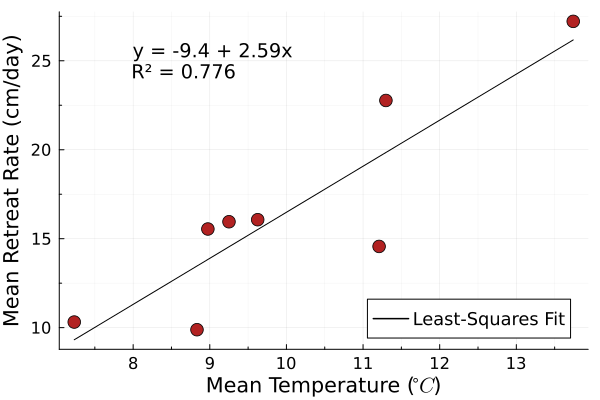

In [73]:
model = lm(@formula(MeanRate ~ MeanTemp), RateTemp)
y_fit = predict(model)

coefs = coef(model)
b0 = coefs[1]        # Intercept
b1 = coefs[2]        # Slope
r2_val = r2(model)

equation_str = "y = $(round(b0, digits=2)) + $(round(b1, digits=2))x"
r2_str = "R² = $(round(r2_val, digits=3))"
annot_str = equation_str * "\n" * r2_str

plot(RateTemp.MeanTemp, y_fit, label="Least-Squares Fit", linewidth=1, color=:black, linestyle=:solid, minorticks=2, minorgrid=true)
scatter!(RateTemp.MeanTemp, RateTemp.MeanRate, xlabel=latexstring("Mean Temperature (\$\\degree C\$)"), ylabel="Mean Retreat Rate (cm/day)", color=:firebrick, 
        markersize=7, legend=:bottomright, label="", tickfontsize=11, guidefontsize=14, legendfontsize=12)
RateTempPlot = Plots.annotate!(8, 25, text(annot_str, :left, 13, "black"))

In [74]:
print(coeftable(model))

────────────────────────────────────────────────────────────────────────
                Coef.  Std. Error      t  Pr(>|t|)  Lower 95%  Upper 95%
────────────────────────────────────────────────────────────────────────
(Intercept)  -9.39667    5.79519   -1.62    0.1560  -23.577      4.78365
MeanTemp      2.58828    0.568528   4.55    0.0039    1.19714    3.97942
────────────────────────────────────────────────────────────────────────

In [75]:
model = lm(@formula(MeanRate ~ MeanTemp + MeanPrecip), RateTemp)
y_fit = predict(model)

coefs = coef(model)
b0 = coefs[1]        # Intercept
b1 = coefs[2]        # Slope
r2_val = adjr2(model)

0.707079674144364

In [76]:
DailyData = CSV.read(raw"C:\Users\cmeri\OneDrive - Dartmouth College\Research\Remote_Sensing\Segmentation\Climate\Daily\DailyClimateData.csv", DataFrame)
DailyPrecip = CSV.read(raw"C:\Users\cmeri\OneDrive - Dartmouth College\Research\Remote_Sensing\Segmentation\Climate\Daily\Precipitation\DailyPrecipData.csv",DataFrame)
sort!(DailyData, :time);
sort!(DailyPrecip, :time);

DailyPrecip.acpcp .= 
if month.(DailyPrecip.time) ∈ [1,3,5,7,8,10,12] 
    DailyPrecip.acpcp .* 31
elseif month.(DailyPrecip.time) == 2 && year.(DailyPrecip.time) ∈ [1980,1984,1988,1992,1996,2000,2004,2008,2012,2016,2020,2024]
    DailyPrecip.acpcp .* 29
elseif month.(DailyPrecip.time) == 2 && year.(DailyPrecip.time) ∉ [1980,1984,1988,1992,1996,2000,2004,2008,2012,2016,2020,2024]
    DailyPrecip.acpcp .* 28
else
    DailyPrecip.acpcp .* 30
end

DailyData = filter(x -> x.year > 2015, DailyData);

In [77]:
DailyData.Bin = floor.((DailyData.DayOfYear .- 1) ./ 10) .+ 1;
DailyPrecip.Bin = floor.((DailyPrecip.DayOfYear .- 1) ./ 10) .+ 1;

In [79]:
bins = [13, 16, 19, 22, 25]
bin_labels = ["130", "160", "190", "220", "250"];

In [80]:
GroupPrecip = groupby(DailyPrecip, :Bin)
GroupPrecip = DataFrames.transform(GroupPrecip, [:acpcp] => ((x) -> mean(x)) => :MeanPrecip, [:acpcp] => ((x) -> sem(x)) => :StErPrecip)
GroupPrecip = unique(GroupPrecip, :Bin)
Pbin = scatter(GroupPrecip.Bin, GroupPrecip.MeanPrecip, yerror=GroupPrecip.StErPrecip, legend=false, xlabel="Day of Year", ylabel=latexstring("Precipitation (\$kg / m^2\$)"), xlims = (12, 26), xticks=(bins,bin_labels));

In [81]:
function BoxData(Data, indicies)
    data = DataFrame()
    results = DataFrame()

    for index in 1:indicies
        df = Data[Data.SlumpID .== "s002", :]
        df = df[df.ID .== index, :]
        sort!(df, :Date)
        minimum_value = abs(minimum(df[:,"Value"]))
        df.Distance .= fill(NaN, nrow(df))
        df.Retreat .= fill(NaN, nrow(df))
        df[1,"Distance"] = 0
        df[1,"Retreat"] = 0
        for i in 2:size(df)[1]
            df[i,"Distance"] = (df[i, "Value"] + minimum_value) .* 10
            df[i, "Retreat"] = df[i,"Distance"] - df[i-1,"Distance"]
        end
        Rate = df.Retreat ./ vcat(NaN, Dates.value.(diff(df.Date)))
        df.Rate = Rate
        data = vcat(data,df)
    end

    data.year = year.(data.Date)

    grouped = groupby(data, :Date)
    Grouped = DataFrames.transform(grouped, [:Rate] => ((x) -> mean(x)) => :AverageRate, [:Rate] => ((x) -> sem(x)) => :StErRate)

    Grouped.Bin = floor.((Grouped.DayOfYear .- 1) ./ 10) .+ 1

    Grouped = unique(Grouped, [:Date])
   return Grouped
end

BoxData (generic function with 1 method)

In [82]:
Boxed = BoxData(Fourier,12)
popfirst!(Boxed)
GroupRetreat = groupby(Boxed, :Bin)
GroupRetreat = DataFrames.transform(GroupRetreat, [:AverageRate] => ((x) -> mean(x)) => :MeanRate, [:AverageRate] => ((x) -> sem(x)) => :StErRate, [:AverageRate] => ((x) -> std(x)) => :StDevRate)
GroupRetreat = unique(GroupRetreat, :Bin);

In [83]:
GroupTemp = groupby(DailyData, :Bin)
GroupTemp = DataFrames.transform(GroupTemp, [:temperature] => ((x) -> mean(x)) => :MeanTemp, [:temperature] => ((x) -> sem(x)) => :StErTemp)
GroupTemp = unique(GroupTemp, :Bin)

Binned = innerjoin(GroupRetreat, GroupTemp, GroupPrecip, on=:Bin, makeunique=true);

In [84]:
model = lm(@formula(MeanRate ~ MeanTemp + MeanPrecip), Binned)
y_fit = predict(model)

coefs = coef(model)
b0 = coefs[1]        # Intercept
b1 = coefs[2]        # Slope
r2_val = adjr2(model)

-0.14651257155837238

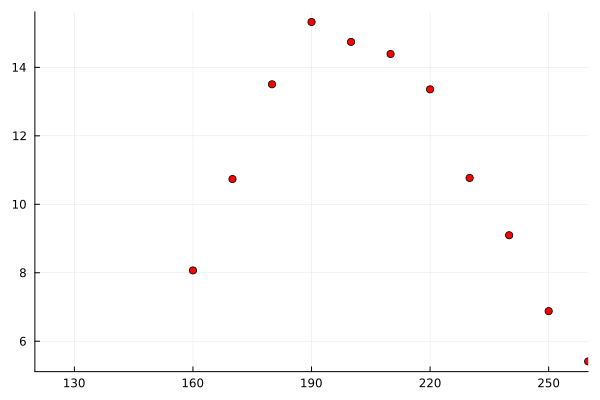

In [85]:
#scatter(Binned.Bin, Binned.MeanPrecip, label="Precipitation", xlabel="Day of Year", xlims = (12, 26), xticks=(bins,bin_labels))
scatter(Binned.Bin, Binned.MeanTemp .- 273.15, legend=false, color=:red, xlims = (12, 26), xticks=(bins,bin_labels))
#Rbin = scatter(Binned.Bin, Binned.MeanRate, yerr=Binned.StErRate, legend=false, color=:green, xlims = (12, 26), xticks=(bins,bin_labels), xlabel="Day of Year", ylabel="Retreat Rate (cm/day)")

In [86]:
LandsatSSC = CSV.read(raw"C:\Users\cmeri\OneDrive - Dartmouth College\Research\Remote_Sensing\Segmentation\Fourier\landsat_ssc_slump_s002.csv",DataFrame)
PlanetSSC = CSV.read(raw"C:\Users\cmeri\OneDrive - Dartmouth College\Research\Remote_Sensing\Segmentation\Fourier\planet_ssc_slump_s002.csv",DataFrame); 

In [87]:
LandsatSSC = filter(x -> x.year > 2015, LandsatSSC)
LandsatSSC.DayOfYear = Dates.dayofyear.(LandsatSSC.sample_dt)
LandsatSSC.Bin = floor.((LandsatSSC.DayOfYear .- 1) ./ 10) .+ 1
grouped = groupby(LandsatSSC, [:Bin, :reference])
Grouped = DataFrames.transform(grouped, [:SSC_mgL] => ((x) -> mean(x)) => :AverageSSC, [:SSC_mgL] => ((x) -> sem(x)) => :StErSSC)
Grouped = unique(Grouped, [:Bin, :reference]);

PlanetSSC = filter(x -> x.year > 2015, PlanetSSC)
PlanetSSC.DayOfYear = Dates.dayofyear.(PlanetSSC.sample_dt)
PlanetSSC.Bin = floor.((PlanetSSC.DayOfYear .- 1) ./ 10) .+ 1
groupedP = groupby(PlanetSSC, [:Bin, :reach])
GroupedP = DataFrames.transform(groupedP, [:SSC_mgL_pred] => ((x) -> mean(x)) => :AverageSSC, [:SSC_mgL_pred] => ((x) -> sem(x)) => :StErSSC)
GroupedP = unique(GroupedP, [:Bin, :reach]);

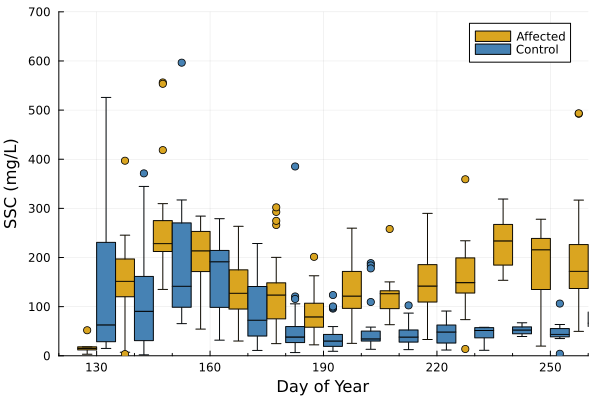

In [88]:
@df filter(x -> x.reach == "Affected", PlanetSSC) boxplot(:Bin .- 0.25, :SSC_mgL_pred, xlabel="Day of Year", ylabel="SSC (mg/L)", xlims = (12, 26), xticks=(bins,bin_labels), bar_width=0.5, label="Affected", color=:goldenrod)
SSCBox = @df filter(x -> x.reach == "Control", PlanetSSC) boxplot!(:Bin .+ 0.25, :SSC_mgL_pred, xlabel="Day of Year", ylabel="SSC (mg/L)", xlims = (12, 26), xticks=(bins,bin_labels), bar_width=0.5, label="Control", xminorticks=3, ylims=(0,700), color=:steelblue)

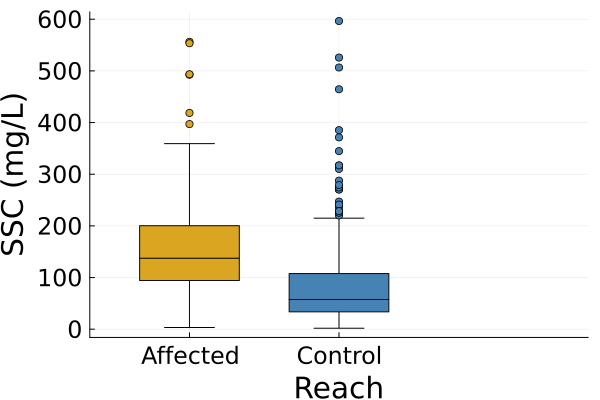

In [89]:
categories = unique(PlanetSSC.reach)

custom_positions = Dict("Affected" => 1.0, "Control" => 1.015)

colorlist = Dict("Control" => :steelblue, "Affected" => :goldenrod)

p = plot()
for c in categories
    subdata = PlanetSSC[PlanetSSC.reach .== c, :]
    xpos = fill(custom_positions[c], nrow(subdata))
    boxplot!(xpos, subdata.SSC_mgL_pred, bar_width = 0.01, label="", color=colorlist[c])
end

xtick_positions = collect(values(custom_positions))
xtick_labels = collect(keys(custom_positions))
p5 = plot!(p, xticks = (xtick_positions, xtick_labels), xlims=(0.99,1.04),
         xlabel = "Reach", ylabel = "SSC (mg/L)", bar_width=0.01, guidefontsize=20, tickfontsize=16)

In [90]:
Affected = filter(x -> x.reach == "Affected", GroupedP)
sort!(Affected, :Bin)
Control = filter(x -> x.reach == "Control", GroupedP)
sort!(Control, :Bin);
rename!(Control, :AverageSSC => :ControlSSC, :StErSSC => :StErControl);

In [91]:
GroupPrecip = filter(x -> 12 < x.Bin < 27, GroupPrecip)
GroupTemp = filter(x -> 12 < x.Bin < 27, GroupTemp)
Binned = filter(x -> 12 < x.Bin < 27, Binned);

In [92]:
Snow = CSV.read(raw"C:\Users\cmeri\OneDrive - Dartmouth College\Research\Remote_Sensing\Segmentation\Fourier\s002_sentinel_2_snow_timeseries.csv",DataFrame)

Snow.DayOfYear = Dates.dayofyear.(Snow.date)
Snow.Bin = floor.((Snow.DayOfYear .- 1) ./ 10) .+ 1
groupedSnow = groupby(Snow, [:Bin])
GroupedSnow = DataFrames.transform(groupedSnow, [:percent_snow] => ((x) -> mean(x)) => :MeanSnow, [:percent_snow] => ((x) -> sem(x)) => :StErSnow)
GroupedSnow = unique(GroupedSnow, [:Bin])
GroupedSnow = filter(x -> 12 < x.Bin < 27, GroupedSnow);

In [93]:
Variables = outerjoin(GroupPrecip[:,["Bin", "MeanPrecip", "StErPrecip"]], GroupTemp[:,["Bin", "MeanTemp", "StErTemp"]],
                        Binned[:,["Bin", "MeanRate", "StErRate"]], Affected[:,["Bin", "AverageSSC", "StErSSC"]],
                        Control[:,["Bin", "ControlSSC", "StErControl"]], GroupedSnow[:,["Bin","MeanSnow","StErSnow"]], on=:Bin);

In [94]:
NARRDaily = DailyPrecip[:,[:time, :acpcp, :year, :month, :DayOfYear, :Bin]];

<h3>Volume<h3>

In [95]:
SluijsData = CSV.read(raw"C:\Users\cmeri\OneDrive - Dartmouth College\Research\Remote_Sensing\Segmentation\Volume\vanderSluijs.csv",DataFrame)
SluijsData = filter(row -> row.Volume_m > 0, SluijsData)
SluijsData.Source .= "van der Sluijs et al. (2023)";
KokeljData = CSV.read(raw"C:\Users\cmeri\OneDrive - Dartmouth College\Research\Remote_Sensing\Segmentation\Volume\KokeljData.csv",DataFrame)
KokeljData.Source .= "Kokelj et al. (2021)"
rename!(KokeljData, :x => :Area_m, :y => :Volume_m);
BernhardData = CSV.read(raw"C:\Users\cmeri\OneDrive - Dartmouth College\Research\Remote_Sensing\Segmentation\Volume\BernhardData.csv",DataFrame);
BernhardData.Source .= "Bernhard et al. (2022)"
DataFrames.transform!(BernhardData, :change_area_year => (x -> x*7.0) => :Area_m, :change_vol_year => (x -> x*7.0) => :Volume_m);

In [96]:
AreaVolume = DataFrame(Area_m=[AreaEstimate], Volume_m=[AreaEstimate*1.8],
    Source=["New Estimate"])
AreaVolume = vcat(AreaVolume,SluijsData[:,["Area_m", "Volume_m", "Source"]], KokeljData, BernhardData[:,["Area_m", "Volume_m", "Source"]]);

┌ Warning: No strict ticks found
└ @ PlotUtils C:\Users\cmeri\.julia\packages\PlotUtils\8mrSm\src\ticks.jl:194
┌ Warning: No strict ticks found
└ @ PlotUtils C:\Users\cmeri\.julia\packages\PlotUtils\8mrSm\src\ticks.jl:194
┌ Warning: No strict ticks found
└ @ PlotUtils C:\Users\cmeri\.julia\packages\PlotUtils\8mrSm\src\ticks.jl:194
┌ Warning: No strict ticks found
└ @ PlotUtils C:\Users\cmeri\.julia\packages\PlotUtils\8mrSm\src\ticks.jl:194


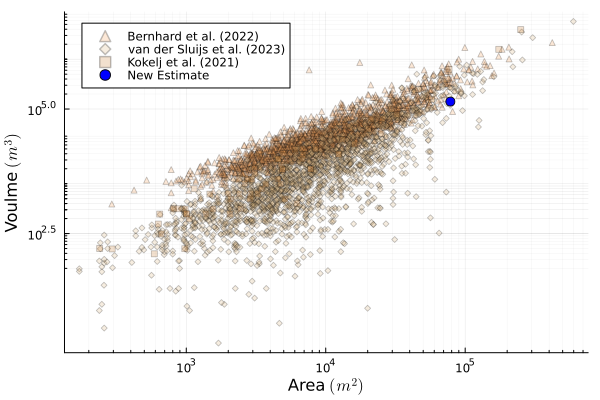

┌ Warning: No strict ticks found
└ @ PlotUtils C:\Users\cmeri\.julia\packages\PlotUtils\8mrSm\src\ticks.jl:194
┌ Warning: No strict ticks found
└ @ PlotUtils C:\Users\cmeri\.julia\packages\PlotUtils\8mrSm\src\ticks.jl:194
┌ Warning: No strict ticks found
└ @ PlotUtils C:\Users\cmeri\.julia\packages\PlotUtils\8mrSm\src\ticks.jl:194


In [97]:
AreaVolume.Source = categorical(AreaVolume.Source, levels=["Bernhard et al. (2022)", "van der Sluijs et al. (2023)", "Kokelj et al. (2021)", "New Estimate"], ordered=true)

scatter(AreaVolume.Area_m, abs.(AreaVolume.Volume_m), group=AreaVolume.Source, legend=:topleft, axis=:log10, 
    xlabel=latexstring("Area \$(m^2)\$"), ylabel=latexstring("Voulme \$(m^3)\$"), markersize=[3 3 3 5], minorticks=:log10, minorgrid=true,
    color=[:sandybrown :burlywood :peru :blue], alpha=[0.25 0.25 0.25 1], markershape=[:utriangle :diamond :square :circle])

In [98]:
ElevationProfile = CSV.read(raw"C:\Users\cmeri\OneDrive - Dartmouth College\Research\Remote_Sensing\Segmentation\Volume\slump_s002_corrected_elevation_profile_2013_2017.csv",DataFrame)
ElevationProfile.Year .= [i <= 1549 ? 2013 : 2017 for i in 1:nrow(ElevationProfile)];

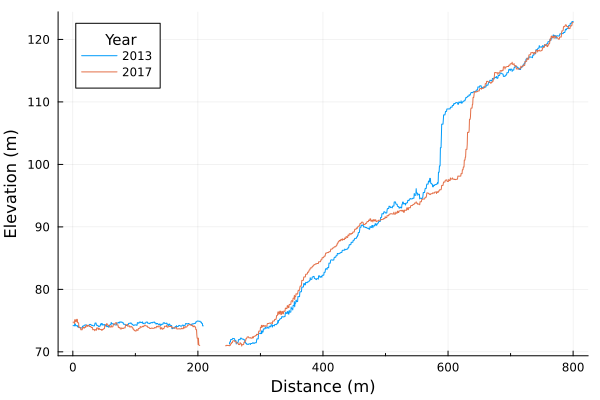

In [99]:
ElevationPlot = plot(ElevationProfile.distance, ElevationProfile.elevation, group=ElevationProfile.Year, legendtitle="Year", legendtitlefontsize=10, xlabel="Distance (m)", ylabel="Elevation (m)", xminorticks=2)

<h3>Upstream Sites<h3>

Defaulting to no water mask.

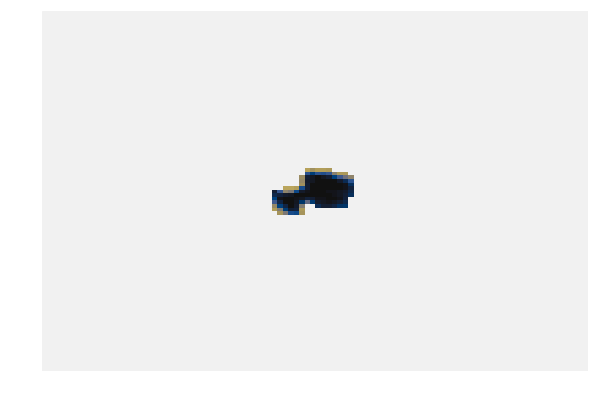

In [100]:
data_path = "C:/Users/cmeri/OneDrive - Dartmouth College/Research/Remote_Sensing/Segmentation/Sentinel/Data/Redownload/Sentinel2_Imagery/Sentinel2-s005"
s005_area = segment_folder(data_path,(50,50),(90,90),Seed3=(5,5),Display=true,refine=true,dilation=2)
s005_area = filter(x -> x.Pixels < 130, s005_area);

In [102]:
years = unique(year.(s005_area.Date))
tick_positions = [Date(y, 1, 1) for y in [2017,2019,2021,2023]]
tick_labels = [string(y) for y in [2017,2019,2021,2023]];

In [103]:
#Monotonic Enforcement
s005_monotonic = DataFrame(s005_area[1, [:Date, :Pixels]])

for i in 2:(size(s005_area)[1])
    if s005_area[i, "Pixels"] >= s005_monotonic[end, "Pixels"]
        append!(s005_monotonic, DataFrame(Pixels=s005_area[i, "Pixels"], Date=s005_area[i, "Date"]))
    end
end
s005_monotonic.Area = s005_monotonic.Pixels .* 100;

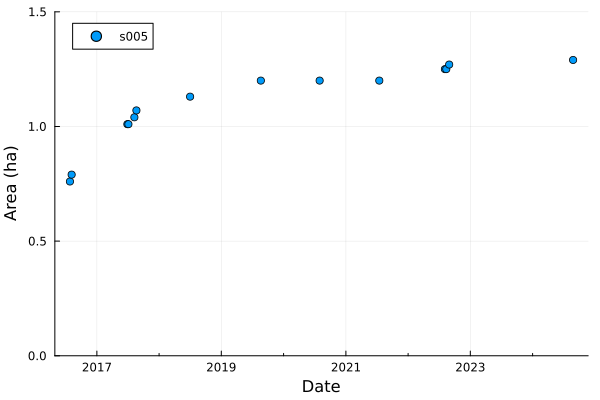

In [104]:
s005_plot = scatter(s005_monotonic.Date, s005_monotonic.Area/1e4, label="s005", xlabel="Date", ylabel="Area (ha)",xticks = (tick_positions, tick_labels), xminorticks=2, ylims=(0,1.5))

In [105]:
preview("C:/Users/cmeri/OneDrive - Dartmouth College/Research/Remote_Sensing/Segmentation/Sentinel/Data/Redownload/Sentinel2_Imagery/Sentinel2-s006/RGB/RGB_2022-09-19.jpg")

Dict{String, Any} with 4 entries:
  "gui"         => Dict{String, Any}("window"=>GtkWindowLeaf(Ptr{GObject} @0x00…
  "roi"         => Dict{String, Any}("redraw"=>ObserverFunction[ObserverFunctio…
  "annotations" => Observable(Dict{UInt64, Any}())
  "clim"        => Observable(CLim{RGB{Float64}}(RGB{Float64}(0.0,0.0,0.0), RGB…

Defaulting to no water mask.

C:\Users\cmeri\OneDrive - Dartmouth College\Research\Remote_Sensing\Segmentation\Sentinel\Select_Bands.py:18: RuntimeWarning: invalid value encountered in divide
  normalized_index = (band1 - band2) / (band1 + band2)  # Add small value to avoid division by zero
C:\Users\cmeri\OneDrive - Dartmouth College\Research\Remote_Sensing\Segmentation\Sentinel\Select_Bands.py:24: RuntimeWarning: invalid value encountered in cast
  normalized_index_uint8 = ((normalized_index - np.min(normalized_index)) / (np.max(normalized_index) - np.min(normalized_index)) * 255).astype(np.uint8)


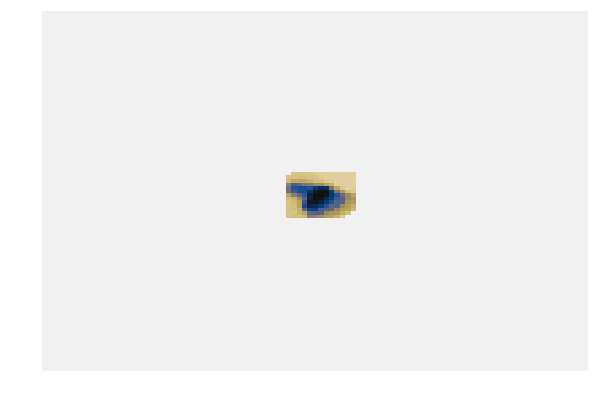

In [106]:
data_path = "C:/Users/cmeri/OneDrive - Dartmouth College/Research/Remote_Sensing/Segmentation/Sentinel/Data/Redownload/Sentinel2_Imagery/Sentinel2-s006"
s006_area = segment_folder(data_path,(52,52),(90,90),Seed3=(5,5),Display=true,refine=true,dilation=5)
s006_area = filter(x -> x.Pixels < 150, s006_area);

In [107]:
#Monotonic Enforcement
s006_monotonic = DataFrame(s006_area[1, [:Date, :Pixels]])

for i in 2:(size(s006_area)[1])
    if s006_area[i, "Pixels"] >= s006_monotonic[end, "Pixels"]
        append!(s006_monotonic, DataFrame(Pixels=s006_area[i, "Pixels"], Date=s006_area[i, "Date"]))
    end
end
s006_monotonic.Area = s006_monotonic.Pixels .* 100;

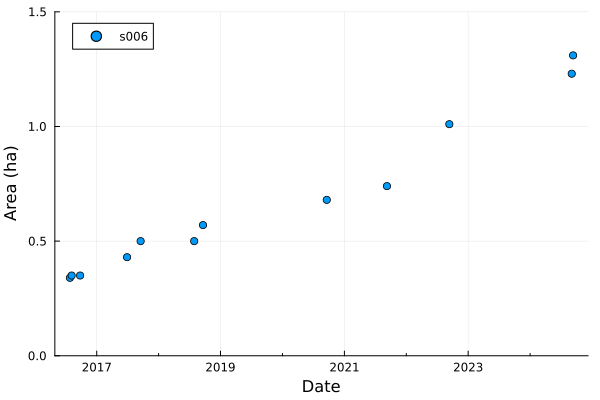

In [108]:
s006_plot = scatter(s006_monotonic.Date, s006_monotonic.Area/1e4, label="s006", xlabel="Date", ylabel="Area (ha)",xticks = (tick_positions, tick_labels), xminorticks=2, ylims=(0,1.5))

Defaulting to no water mask.

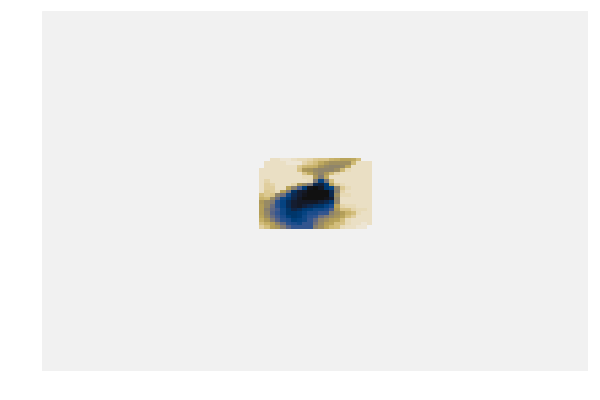

In [109]:
data_path = "C:/Users/cmeri/OneDrive - Dartmouth College/Research/Remote_Sensing/Segmentation/Sentinel/Data/Redownload/Sentinel2_Imagery/Sentinel2-s007"
s007_area = segment_folder(data_path,(53,50),(90,90),Seed3=(5,5),Display=true,refine=true,dilation=8)
s007_area = filter(x -> x.Pixels < 400, s007_area);

In [110]:
#Monotonic Enforcement
s007_monotonic = DataFrame(s007_area[1, [:Date, :Pixels]])

for i in 2:(size(s007_area)[1])
    if s007_area[i, "Pixels"] >= s007_monotonic[end, "Pixels"]
        append!(s007_monotonic, DataFrame(Pixels=s007_area[i, "Pixels"], Date=s007_area[i, "Date"]))
    end
end
s007_monotonic.Area = s007_monotonic.Pixels .* 100;

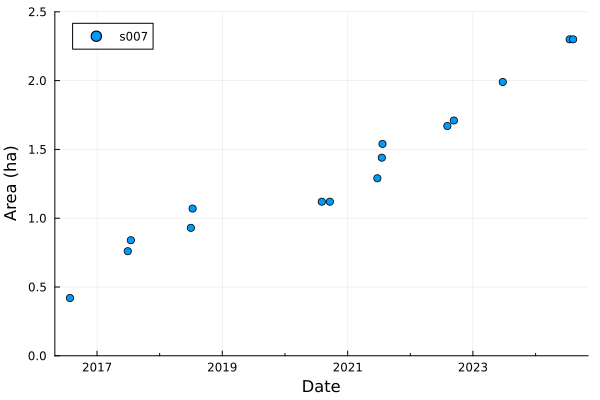

In [111]:
s007_plot = scatter(s007_monotonic.Date, s007_monotonic.Area/1e4, label="s007", xlabel="Date", ylabel="Area (ha)", xticks = (tick_positions, tick_labels), xminorticks=2, ylims=(0,2.5))

In [112]:
s005_monotonic.Year = year.(s005_monotonic.Date)
s006_monotonic.Year = year.(s006_monotonic.Date)
s007_monotonic.Year = year.(s007_monotonic.Date)

s005_group = combine(groupby(s005_monotonic, :Year), :Area => mean => :MeanArea)
s006_group = combine(groupby(s006_monotonic, :Year), :Area => mean => :MeanArea)
s007_group = combine(groupby(s007_monotonic, :Year), :Area => mean => :MeanArea)

UpstreamArea = vcat(s005_group, s006_group, s007_group)
UpstreamArea = combine(groupby(UpstreamArea, :Year), :MeanArea => sum => :TotalArea)
UpstreamArea = filter(x -> x.Year ∉ [2019,2023], UpstreamArea)

Row,Year,TotalArea
,Int64,Float64
1,2016,15416.7
2,2017,22975.0
3,2018,26650.0
4,2020,30000.0
5,2021,33633.3
6,2022,39566.7
7,2024,48600.0


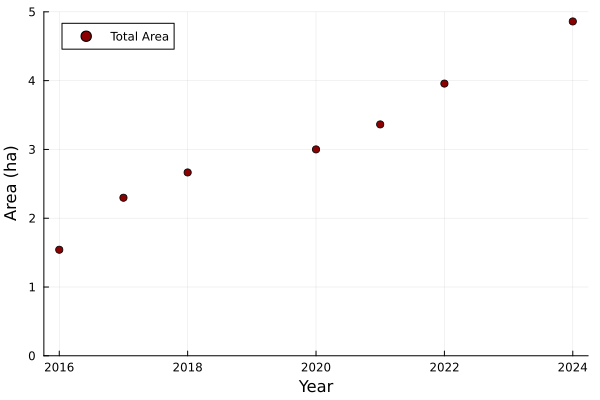

In [113]:
Total_plot = scatter(UpstreamArea.Year, UpstreamArea.TotalArea / 1e4, label="Total Area", xlabel="Year", ylabel="Area (ha)", color=:darkred, ylims=(0,5))

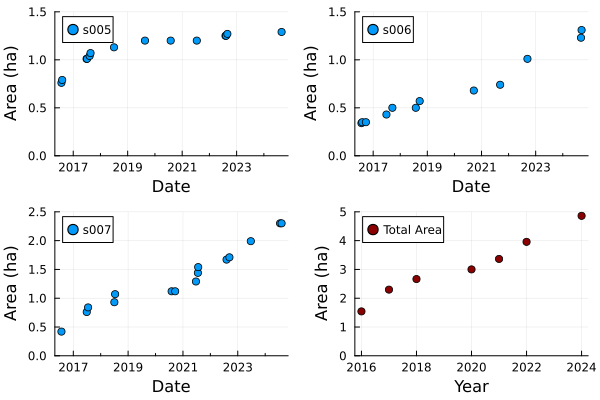

In [114]:
UpstreamPanels = plot(s005_plot, s006_plot, s007_plot, Total_plot)